# Визуализация.

Датасет представляет собой коллекцию медицинских и демографических данных пациентов, а также их статус диабета (положительный или отрицательный). Данные включают такие характеристики, как возраст, пол, индекс массы тела (ИМТ), гипертония, сердечно-сосудистые заболевания, история курения, уровень HbA1c и уровень глюкозы в крови. 

В будущем этот датасет может быть использован для построения моделей машинного обучения для прогнозирования диабета у пациентов на основе их истории болезни и демографической информации. Это может быть полезно для медицинских работников при выявлении пациентов, которые могут быть подвержены риску развития диабета, и при разработке персонализированных планов лечения.

Описание столбцов:

|Название| Описание |
|--|--|
|`gender`| Пол пациента |
|`age`| Возраст |
|`hypertension`| Гипертония —  это состояние, при котором кровяное давление в артериях постоянно повышено. Он принимает значения 0 или 1, где 0 означает отсутствие гипертонии, а 1 —  наличие гипертонии. |
|`heart_disease`| Болезни сердца —  это еще одно состояние, которое связано с повышенным риском развития диабета. Он также принимает значения 0 или 1, где 0 означает отсутствие сердечных заболеваний, а 1 —  наличие сердечных заболеваний. |
|`smoking_history`| Опыт курения —  также считается фактором риска развития диабета и может усугубить осложнения, связанные с диабетом. | 
|`bmi`| Это показатель количества жира в организме, основанный на весе и росте. Более высокие значения ИМТ связаны с повышенным риском развития диабета. Диапазон ИМТ в наборе данных составляет от 10,16 до 71,55. ИМТ менее 18,5 —  это недостаточный вес, 18,5-24,9 —  нормальный, 25-29,9 —  избыточный вес, а 30 и более —  ожирение. |
|`HbA1c_level`| Уровень HbA1c (гемоглобин A1c) —  это показатель среднего уровня сахара в крови человека за последние 2-3 месяца. Более высокий уровень указывает на больший риск развития диабета. В основном более 6,5% уровня HbA1c указывает на диабет. | 
|`blood_glucose_level`| Уровень глюкозы в крови —  это количество глюкозы в крови в определенный момент времени. Высокий уровень глюкозы в крови является основным признаком диабета. |
|`diabetes`| Диабет является целевой переменной (таргетом), при этом значение 1 указывает на наличие диабета, а 0 —  на его отсутствие. |

## Задание

Проведите визуализацию данных и попробуйте выяснить причины, от чего и с чем связаны основные причины наличия диабета у людей.

Ваша цель —  визуально с помощью графиков определить и доказать, что при наличии какого-либо фактора возможен риск развития диабета.

Этапы выполнения задания (наш pipeline):

1. Загрузка и предобработка данных (при необходимости)
2. Описательный анализ данных, просмотр данных
3. Построение гистограмм числовых переменных
4. Построение диаграмм размаха для определения наличия выбросов (ящики с усами) числовых переменных
5. Построение столбчатых диаграмм для категориальных переменных
6. Построение матрицы корреляции признаков (Phik или Пирсона)
7. Сравнение двух выборок
8. Общий вывод

## Загрузка данных

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from phik import phik_matrix
from phik.report import plot_correlation_matrix


In [3]:
df = pd.read_csv(r"C:\Users\elshi\Desktop\diabetes_prediction_dataset .csv")
df.head()

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,current,23.45,5.0,155,0
4,Male,76.0,1,1,current,20.14,4.8,155,0


## Описательный анализ данных

Рассмотрите данные —  изучите медианы, средние, дисперсии и т.д. 

Что можете сказать о данных? Сделайте вывод.

In [13]:
df.drop(df[df['gender'] == 'Other'].index, inplace = True)

dict_to_replace = {'Female': 0, 'Male': 1, 'never': 0, 'No Info': np.NaN, 'current': 1, 'former': 0.3, 'ever': 1, 'not current': 0.5}

for col in df.columns:
    print(f'Среднее значение {col}:', round(df[col].replace(dict_to_replace).mean(), 3))
print()
for col in df.columns:
    print(f'медианное значение {col}:', round(df[col].replace(dict_to_replace).median(), 3))

Среднее значение gender: 0.414
Среднее значение age: 41.888
Среднее значение hypertension: 0.075
Среднее значение heart_disease: 0.039
Среднее значение smoking_history: 0.301
Среднее значение bmi: 27.321
Среднее значение HbA1c_level: 5.528
Среднее значение blood_glucose_level: 138.058
Среднее значение diabetes: 0.085

медианное значение gender: 0.0
медианное значение age: 43.0
медианное значение hypertension: 0.0
медианное значение heart_disease: 0.0
медианное значение smoking_history: 0.0
медианное значение bmi: 27.32
медианное значение HbA1c_level: 5.8
медианное значение blood_glucose_level: 140.0
медианное значение diabetes: 0.0


C:\Users\elshi\AppData\Local\Temp\ipykernel_24404\1297256161.py:6: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`

C:\Users\elshi\AppData\Local\Temp\ipykernel_24404\1297256161.py:9: FutureWarning:

Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



**Вывод:** 
1. Возраст наблюдаемых пациентов от 8 месяцев до 80 лет
2. Средний возраст пациетов - 43 года
3. ИМТ средний составляет 27,32%, что является избыточной массой тела
4. Только около 7.5% участников имеют гипертонию.
5. Лишь около 3.9% имеют сердечные заболевания.
6.  Средний уровень сахара в крови составляет 5,80% у пациентов 
7. HbA1c - 5.53 (Медиана выше среднего, что может указывать на небольшое смещение влево (наличие низких значений))
8. Глюкоза - 138.06 (начения сбалансированы, но в целом находятся на верхней границе нормы или выше, что может быть тревожным признаком)
9. Примерно 30% участников имеют историю курения, однако большинство — некурящие.
10. Диабет зафиксирован примерно у 8.5% участников, что делает выборку несильно несбалансированной, но с перекосом в сторону здоровых.

## Предобработка данных

### Дубликаты

Предобработайте датасет —  проверьте на наличие дубликатов и удалите, если они есть.

In [5]:
df.drop_duplicates()

,gender,age,hypertension,heart_disease,smoking_history,bmi,HbA1c_level,blood_glucose_level,diabetes
0,Female,80.0,0,1,never,25.19,6.6,140,0
1,Female,54.0,0,0,No Info,27.32,6.6,80,0
2,Male,28.0,0,0,never,27.32,5.7,158,0
3,Female,36.0,0,0,current,23.45,5.0,155,0
4,Male,76.0,1,1,current,20.14,4.8,155,0
...,...,...,...,...,...,...,...,...,...
99994,Female,36.0,0,0,No Info,24.60,4.8,145,0
99996,Female,2.0,0,0,No Info,17.37,6.5,100,0
99997,Male,66.0,0,0,former,27.83,5.7,155,0
99998,Female,24.0,0,0,never,35.42,4.0,100,0


### Отсутствующие значения

Предобработайте датасет — проверьте на наличие NaN и удалите или заполните значения.

In [8]:
print("Есть ли пропуски в данных?:", df.isnull().values.any())
# Удаление строк с пропусками (для своего же спокойствия)
df_cleaned = df.dropna()
# Проверка после обработки
print("Пропуски после очистки:")
print(df.isnull().sum())


Есть ли пропуски в данных?: False
Пропуски после очистки:
gender                 0
age                    0
hypertension           0
heart_disease          0
smoking_history        0
bmi                    0
HbA1c_level            0
blood_glucose_level    0
diabetes               0
dtype: int64


### Изменение типа данных

Рассмотрев все данные, замените типы на нужные (при необходимости):

- Если есть числа — на `int` или `float`
- Если категории — можно оставить `object`

In [10]:
df.dtypes

gender                  object
age                    float64
hypertension             int64
heart_disease            int64
smoking_history         object
bmi                    float64
HbA1c_level            float64
blood_glucose_level      int64
diabetes                 int64
dtype: object

**Вывод:** Нет необходимости в смене данных.

## Визуализация

Построим графики:

1. Построение гистограмм числовых переменных
2. Построение диаграмм размаха для определения наличия выбросов (ящики с усами) числовых переменных
3. Построение столбчатых диаграмм для категориальных переменных
4. Построение матрицы корреляции признаков (Phik или Пирсона)

После построения опишите выборку. Что она из себя представляет? Есть ли зависимости?

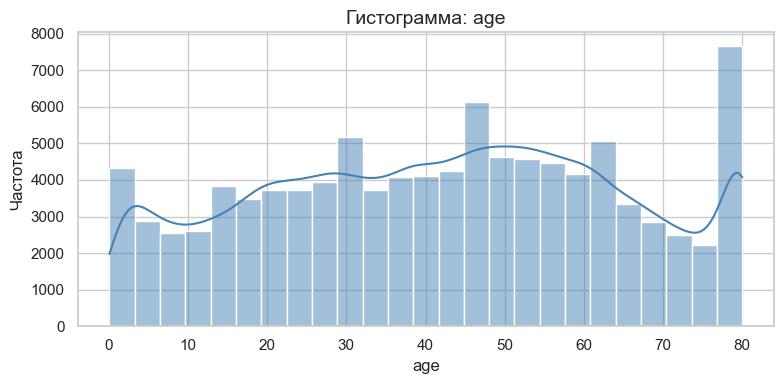

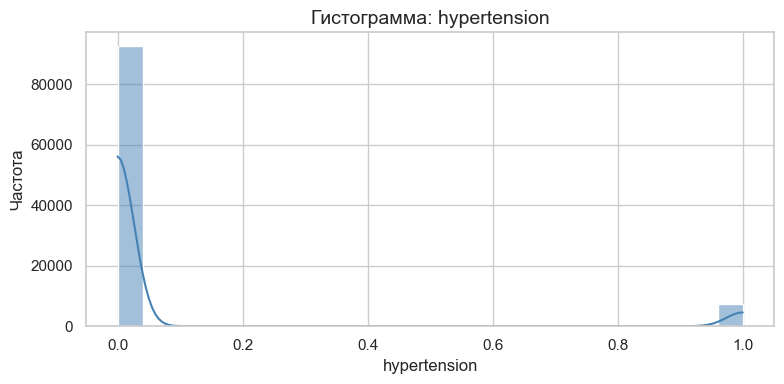

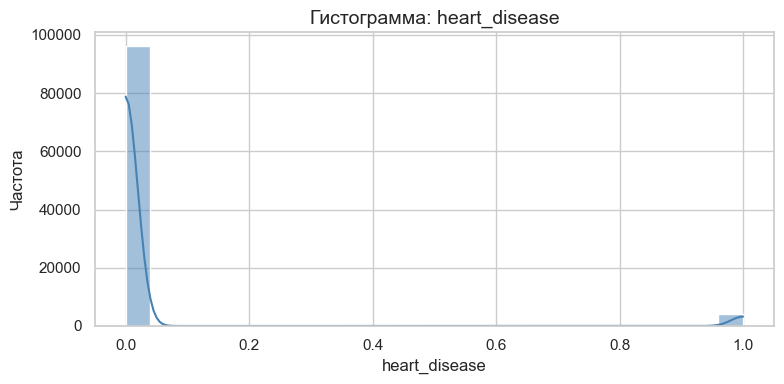

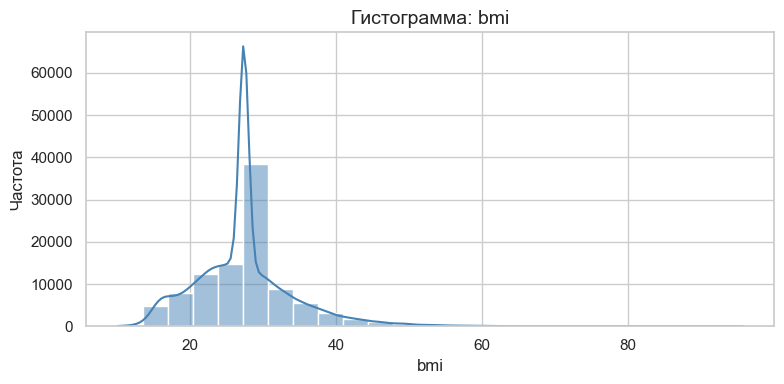

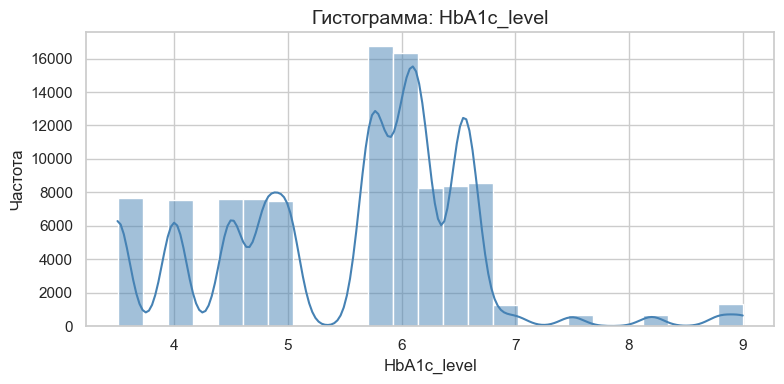

...

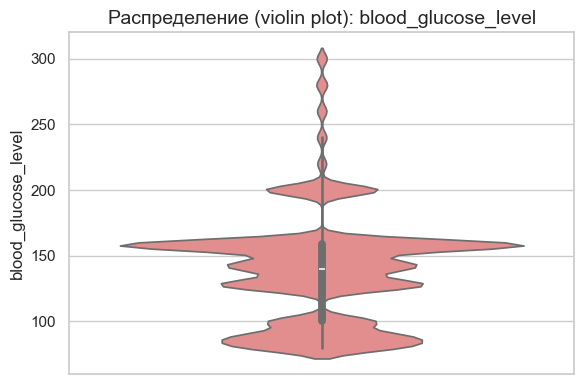

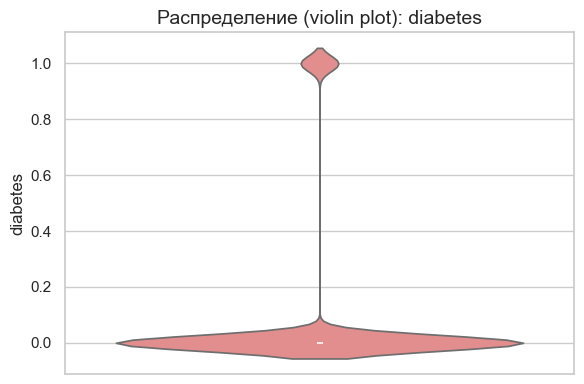

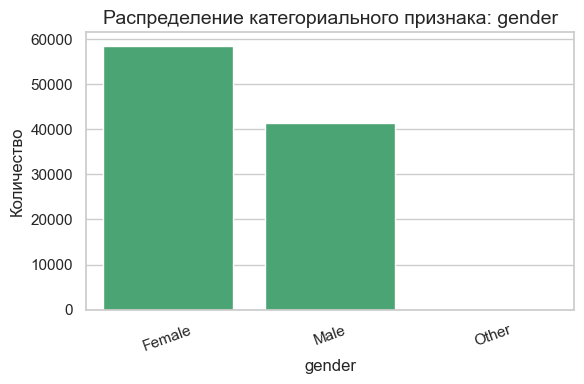

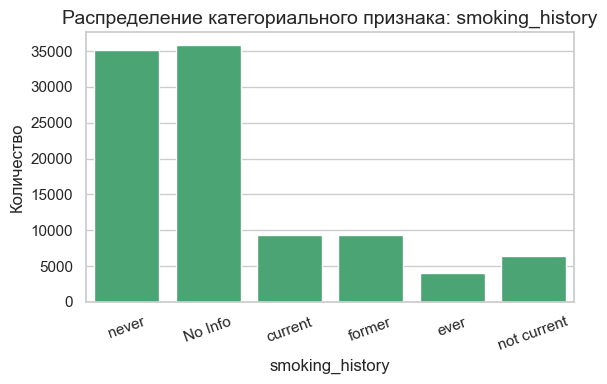

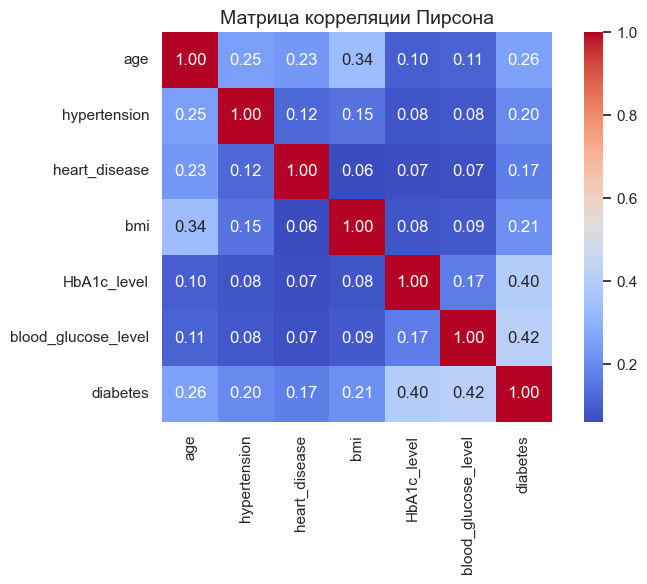

interval columns not set, guessing: ['age', 'hypertension', 'heart_disease', 'bmi', 'HbA1c_level', 'blood_glucose_level', 'diabetes']


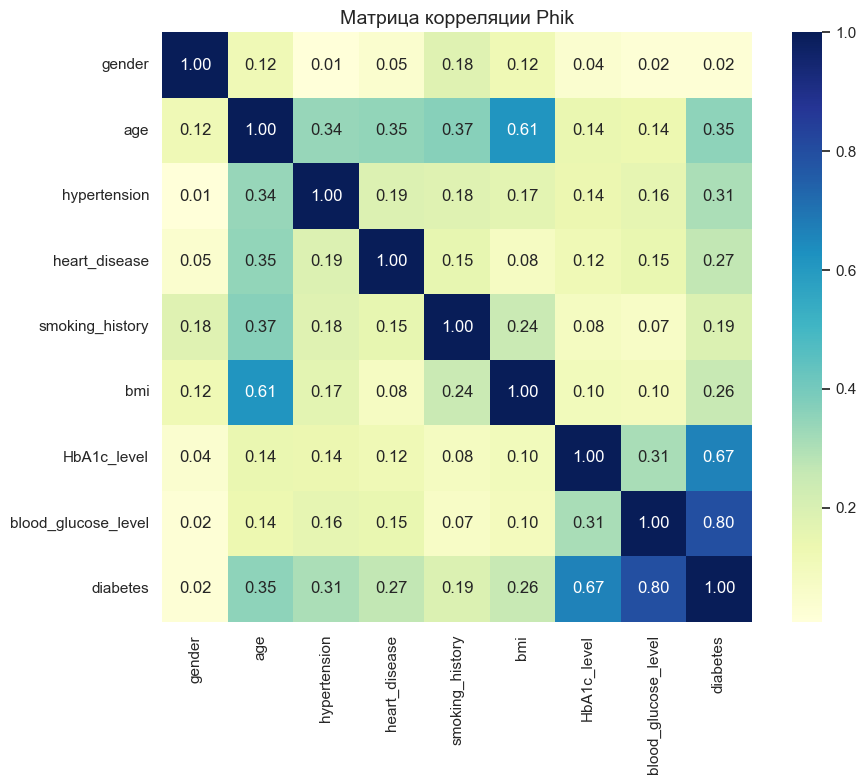

In [11]:
import seaborn as sns
import matplotlib.pyplot as plt

# Настройки стиля
sns.set(style='whitegrid', palette='muted')
plt.rcParams.update({'axes.titlesize': 14, 'axes.labelsize': 12})
# Определим числовые и категориальные переменные автоматически
numeric_cols = df.select_dtypes(include='number').columns.tolist()
categorical_cols = df.select_dtypes(exclude='number').columns.tolist()

# ===== Гистограммы числовых переменных =====
for col in numeric_cols:
    plt.figure(figsize=(8, 4))
    sns.histplot(data=df, x=col, bins=25, kde=True, color='steelblue')
    plt.title(f'Гистограмма: {col}')
    plt.xlabel(col)
    plt.ylabel('Частота')
    plt.tight_layout()
    plt.show()

# ===== Violinplot (вместо boxplot) =====
for col in numeric_cols:
    plt.figure(figsize=(6, 4))
    sns.violinplot(y=df[col], inner='box', color='lightcoral')
    plt.title(f'Распределение (violin plot): {col}')
    plt.ylabel(col)
    plt.tight_layout()
    plt.show()

# ===== Столбчатые диаграммы для категориальных переменных =====
for col in categorical_cols:
    plt.figure(figsize=(6, 4))
    sns.countplot(data=df, x=col, color='mediumseagreen')
    plt.title(f'Распределение категориального признака: {col}')
    plt.xlabel(col)
    plt.ylabel('Количество')
    plt.xticks(rotation=20)
    plt.tight_layout()
    plt.show()

# ===== Матрица корреляции Пирсона =====
plt.figure(figsize=(8, 6))
sns.heatmap(df[numeric_cols].corr(), annot=True, fmt=".2f", cmap='coolwarm', square=True)
plt.title('Матрица корреляции Пирсона')
plt.tight_layout()
plt.show()

# ===== Матрица корреляции Phik =====
phik_corr = df.phik_matrix()

plt.figure(figsize=(10, 8))
sns.heatmap(phik_corr, annot=True, fmt=".2f", cmap='YlGnBu', square=True)
plt.title('Матрица корреляции Phik')
plt.tight_layout()
plt.show()


**Выводы***
1. Основное: 
- Диабет и HbA1c_level: Повышенный уровень гликированного гемоглобина чётко ассоциирован с наличием диабета.
- Диабет и blood_glucose_level: Гипергликемия (высокий уровень глюкозы в крови) напрямую указывает на диабет.
- Возраст и сердечно-сосудистые заболевания: С возрастом значительно возрастает риск наличия heart_disease.
- Пол (gender): Не демонстрирует заметных корреляций с другими признаками.
- Очень высокие значения HbA1c и глюкозы у отдельных пациентов — потенциальные случаи тяжёлого или запущенного диабета.
- Пол: Женщины составляют большинство (около 60–70%).
- Возраст: Широкий диапазон — от новорождённых до пожилых (80+ лет).
- Большинство пациентов не страдают гипертонией и сердечными заболеваниями.
- Диабет диагностирован примерно у 8–9% участников
2. Ключевые зависимости: 
- Наличие диабета сильно связано с повышенными значениями HbA1c_level и blood_glucose_level.
- Пожилой возраст увеличивает вероятность сердечных заболеваний.

## Сравнение выборок

После построения всех типов графиков, необходимо провести анализ:

Отобразите на одном графике две выборки — люди с диабетом и без и сравните их.

1. Для числовых признаков — гистограммы и ящики с усами.
2. Для категориальных — столбчатые диаграммы.

После напишите вывод, есть ли какая-то зависимость?

In [16]:
import plotly.express as px

# Глобальные параметры оформления
base_layout = dict(
    template='plotly_white',
    title_x=0.5,
    legend_title_text='Диабет',
    legend=dict(x=0.01, y=0.99, borderwidth=0),
    margin=dict(l=40, r=40, t=60, b=40),
    font=dict(size=14)
)

# Гистограмма по первому числовому признаку
first_col = numeric_cols[0]
fig = px.histogram(
    df, x=first_col, color='diabetes',
    nbins=30,
    opacity=0.75,
    barmode='overlay',
    histfunc='count',
    color_discrete_sequence=['#636EFA', '#EF553B'],
    title=f'Распределение по {first_col} с учетом диабета',
    labels={'diabetes': 'Диабет', first_col: first_col}
)
fig.update_traces(marker_line_width=1, marker_line_color='white')
fig.update_layout(
    **base_layout,
    xaxis_title=first_col,
    yaxis_title='Количество'
)
fig.show()

# Ящики с усами для числовых признаков
for col in numeric_cols:
    fig = px.box(
        df, x='diabetes', y=col,
        color='diabetes',
        color_discrete_sequence=['#636EFA', '#EF553B'],
        title=f'{col}: распределение по группам диабета (ящик с усами)',
        labels={'diabetes': 'Диабет', col: col}
    )
    fig.update_layout(
        **base_layout,
        xaxis_title='Диабет',
        yaxis_title=col
    )
    fig.show()

# Гистограммы для категориальных переменных
for col in categorical_cols:
    fig = px.histogram(
        df, x=col, color='diabetes',
        barmode='group',
        color_discrete_sequence=['#636EFA', '#EF553B'],
        title=f'{col} с учетом диабета',
        labels={'diabetes': 'Диабет', col: col}
    )
    fig.update_layout(
        **base_layout,
        xaxis_title=col,
        yaxis_title='Количество'
    )
    fig.show()


**Вывод:**
1. Сильная связь с диабетом:
- Повышенные значения HbA1c и уровня глюкозы в крови являются основными индикаторами наличия диабета.
- Избыточная масса тела (BMI > 30) и возраст старше 50 лет значительно увеличивают риск заболевания.
2. Умеренная связь:
- Гипертония и сердечно-сосудистые заболевания нередко сопутствуют диабету, однако не являются прямыми предикторами.
3. Слабая или отсутствующая связь:
- Пол и факт курения не демонстрируют существенного влияния на вероятность развития диабета.

## ЗАДАЧИ PRO

Мы провели базовый анализ выше и сделали выводы.

Но даёт ли этот результат полную картину? Наша цель — узнать, каков риск возникновения диабета у пациента.

Ваша задача — воспользоваться ранее приобретенными навыками и дополнить общий вывод. 

**Этапы:**

1) Разделите выборки и постройте дополнительные графики. Может стоит разделить на несколько выборок и сравнить графики там?
2) Постройте `pairplot` с параметром `hue=='diabetes'`. Может там тоже где-то кроется истина?
2) Постройте тепловую карту корреляции `Phik` и сделайте дополнительный вывод.
3) Дополните общий вывод. 

**Примечание:** задание не ограничено только этими этапами. Можно их дополнить — может стоит сделать фильтр данных, рассмотреть данные под другим углом и провести дополнительную аналитику? Средствами и методами не ограничены.

c:\Users\elshi\anaconda3\Lib\site-packages\phik\data_quality.py:59: UserWarning:

The number of unique values of variable bmi is large: 4247. Are you sure this is not an interval variable? Analysis for pairs of variables including bmi can be slow.



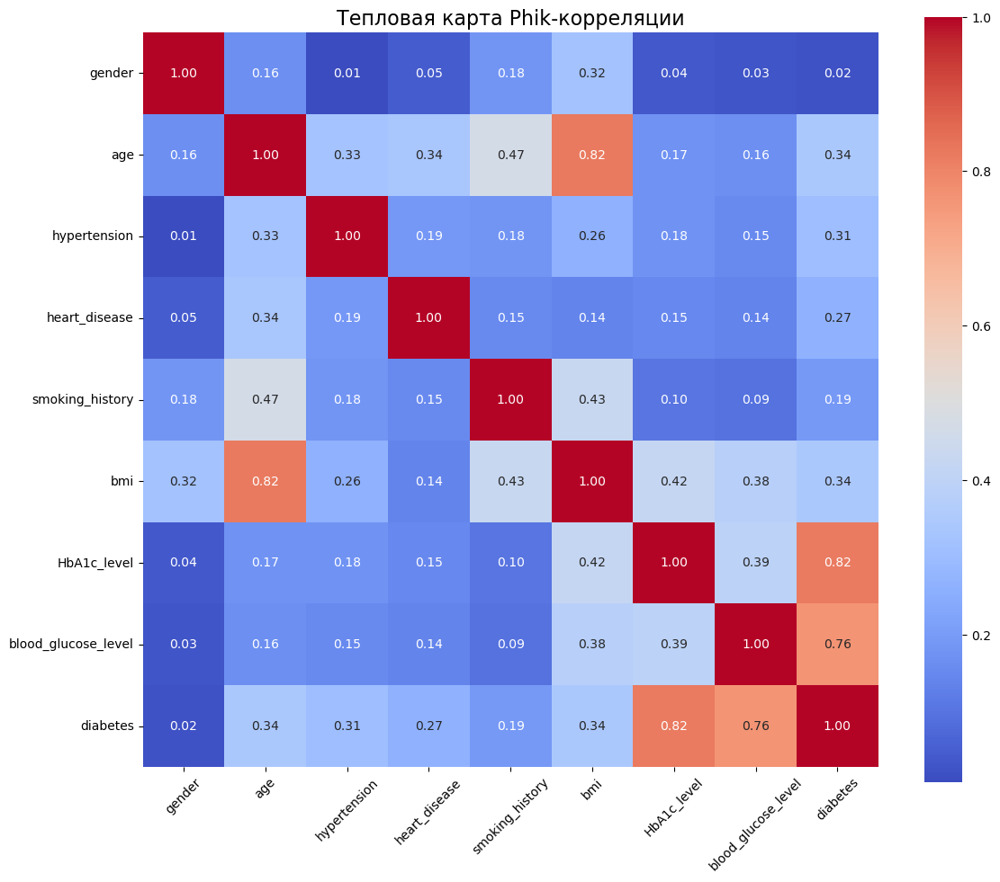

In [ ]:
import plotly.express as px

# Разделим данные по наличию диагноза диабета
df_diabetes = df[df['diabetes'] == 1]
df_no_diabetes = df[df['diabetes'] == 0]

# Гистограмма возраста с учётом диабета
fig = px.histogram(
    df,
    x='age',
    color='diabetes',
    barmode='stack',
    nbins=30,
    title='Распределение пациентов по возрасту с учётом диабета',
    labels={'age': 'Возраст', 'diabetes': 'Наличие диабета'},
    color_discrete_sequence=['#636EFA', '#EF553B']  # синий и оранжевый
)
fig.update_layout(
    template='plotly_white',
    bargap=0.05,
    legend_title_text='Диабет',
    xaxis_title='Возраст',
    yaxis_title='Количество пациентов'
)
fig.show()

# Гистограмма истории курения с учётом диабета
fig = px.histogram(
    df,
    x='smoking_history',
    color='diabetes',
    barmode='stack',
    title='История курения пациентов с учётом диабета',
    labels={'smoking_history': 'История курения', 'diabetes': 'Наличие диабета'},
    color_discrete_sequence=['#636EFA', '#EF553B']
)
fig.update_layout(
    template='plotly_white',
    bargap=0.15,
    legend_title_text='Диабет',
    xaxis_title='Категория курения',
    yaxis_title='Количество пациентов'
)
fig.show()

# Box-график BMI
fig = px.box(
    df,
    x='diabetes',
    y='bmi',
    color='diabetes',
    title='BMI в зависимости от наличия диабета',
    labels={'diabetes': 'Наличие диабета', 'bmi': 'Индекс массы тела (BMI)'},
    color_discrete_sequence=['#636EFA', '#EF553B']
)
fig.update_layout(
    template='plotly_white',
    xaxis_title='Диабет',
    yaxis_title='BMI',
    legend_title_text='Диабет'
)
fig.show()


# Вычисление матрицы Phik
phik_matrix = df.phik_matrix(interval_cols=[])

# Визуализация тепловой карты
plt.figure(figsize=(12, 10))
sns.heatmap(phik_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True)
plt.title('Тепловая карта Phik-корреляции', fontsize=16)
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()



**Вывод**
1. Распределение пациентов по возрасту с учетом диабета:
- Пиковый рост заболеваемости замечен у возрастных групп: 48-52 года, однако начало роста заболеваемости наблюдается уже в возрасте от 38 лет. Это может быть обусловлено...
2. История курения пациентов с учетом диабета не показала значимых факторов к увеличению рисокв заболеваемости диабетом. 
3. BMI в зависимости от наличия диабета:
- Показатель ИМТ среди диабетиков в среднем имеют 29,97%, что уже относится к категории ожирения 1 степени (ИМТ: 28-30,9) 
- Увеличение массы тела обсуловлена некорректными выработками инсулина, что является клиническим подтверждением заболевания
4. Тепловая карта Phik-корреляции:
- Age и BMI также показали умеренную корреляцию, что указывает на возрастной и весовой вклад в развитие диабета.
- HbA1c_level и blood_glucose_level — высокая зависимость, что логично, так как это ключевые медицинские показатели диабета.
- Smoking_history и hypertension имеют более слабую, но заметную связь — что может свидетельствовать о косвенном влиянии на риск диабета.

# Общий вывод

1. Числовые признаки:
- HbA1c и уровень глюкозы в крови — ключевые биомаркеры диабета. У больных диабетом они существенно выше, чем у здоровых.
- Возраст и индекс массы тела (BMI) также повышены у диабетиков, но различия менее выражены по сравнению с глюкозой и HbA1c.

2. Категориальные признаки:
- Гипертония и история курения чаще встречаются у пациентов с диабетом, однако эти признаки демонстрируют слабую или умеренную связь.
- Пол оказывает незначительное влияние: мужчины незначительно чаще страдают диабетом.

3. Результаты визуализации и корреляционного анализа
- Графики распределения по числовым признакам выявили отдельные кластеры пациентов с диабетом, что может использоваться для построения диагностических и предсказательных моделей.
- HbA1c и уровень глюкозы показали наибольшую корреляцию с наличием диабета.
- Phik-корреляция подтвердила:
*Высокую зависимость диабета от HbA1c и глюкозы.
*Умеренную связь с возрастом и BMI, что подчёркивает значимость возрастно-весовых факторов.
*Слабую, но заметную связь с гипертонией и курением — возможно, как с факторами риска, так и как следствием образа жизни.

4. Частные наблюдения
- Возраст и диабет: пик заболеваемости наблюдается в возрастной группе 48–52 года, при этом тенденция к росту начинается уже с 38 лет. Это может быть связано с метаболическими и гормональными изменениями.
- Курение: история курения не выявила явной зависимости с риском диабета, но может усиливать влияние других факторов, таких как гипертония.
- Индекс массы тела (BMI): средний BMI у диабетиков составляет около 29.97, что соответствует ожирению I степени.
Это подтверждает клиническую взаимосвязь между нарушением метаболизма, лишним весом и диабетом.

5. Выводы и рекомендации
- Основные биомаркеры — HbA1c и уровень глюкозы в крови — следует использовать как первичные показатели при диагностике.
- Дополнительные факторы риска — возраст, ожирение, гипертония, болезни сердца — должны учитываться в оценке риска.
- Поведенческие факторы — история курения, пол — обладают меньшей значимостью, но могут усиливать действие других признаков.
- Результаты анализа и визуализации позволяют строить информативные модели машинного обучения, в которых наибольший вес следует отдать показателям HbA1c и глюкозы.